In [1]:
import pandas as pd
import matplotlib.pyplot as plt


In [3]:
df_2016 = pd.read_csv("../datasets/2016_restaurants.csv")
df_2017 = pd.read_csv("../datasets/2017-2018_restaurants.csv")
df_2017_2019 = pd.read_csv("../datasets/2017-2018-2019_restaurants.csv")
df_2016.set_index("business_id", inplace=True)
df_2017.set_index("business_id", inplace=True)
df_2017_2019.set_index("business_id", inplace=True)
df_2017.fillna(0, inplace=True)
df_2017_2019.fillna(0, inplace=True)

In [4]:
print(len(df_2016))
print(len(df_2017))
print(len(df_2017_2019))

27251
30094
30094


## Mania Idea (Only for Reference)

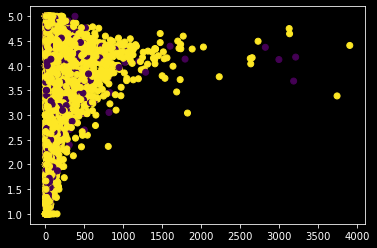

In [9]:
plt.scatter(df_2016["visit_count"], df_2016["raw_stars"], c=df_2016["is_open"])

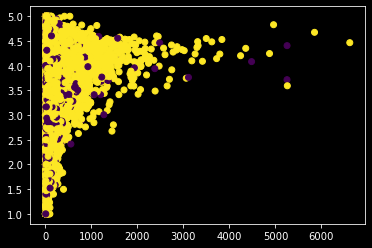

In [10]:
plt.scatter(df_2017["visit_count"], df_2017["raw_stars"], c=df_2017["is_open"])

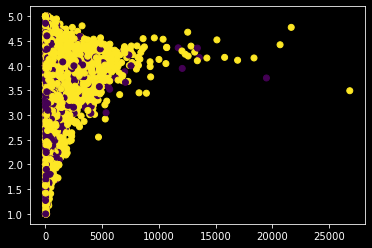

In [41]:
df_2011 = pd.read_csv("datasets/2011-2018_restaurants.csv")
plt.scatter(df_2011["visit_count"], df_2011["raw_stars"], c=df_2011["is_open"])

In [5]:
def pop_mania(df):
    mania = df[(df["raw_stars"] >= df["raw_stars"].describe()["75%"]) & (df["visit_count"] < df["visit_count"].describe()["50%"])& (df["visit_count"] >= df["visit_count"].describe()["25%"])]
    pop = df[(df["visit_count"] >= df["visit_count"].describe()["50%"])]
    unpop = df[(df["raw_stars"] < df["raw_stars"].describe()["25%"]) & (df["visit_count"] < df["visit_count"].describe()["25%"])]

    get_closed_ratio(df, mania)
    get_closed_ratio(df, pop)
    get_closed_ratio(df, unpop)


In [6]:
pop_mania(df_2016)

20.53%
random: 22.64%
20.58%
random: 20.89%
19.18%
random: 20.07%


In [7]:
mania = df_2017[(df_2017["raw_stars"] >= 4.166667) & (df_2017["visit_count"] < 35.000000)]
pop = df_2017[(df_2017["visit_count"] >= 35.000000)]
unpop = df_2017[(df_2017["raw_stars"] < 4.166667) & (df_2017["visit_count"] < 35.000000)]

get_closed_ratio(df_2017, mania)
get_closed_ratio(df_2017, pop)
get_closed_ratio(df_2017, unpop)

23.4%
random: 17.99%
17.2%
random: 18.58%
20.28%
random: 18.05%


In [9]:
mania = df_2011[(df_2011["weighted_stars"] >= 4.062915) & (df_2011["visit_count"] < df_2011["visit_count"].mean())]
pop = df_2011[(df_2011["visit_count"] >= df_2011["visit_count"].mean())]
unpop = df_2011[(df_2011["weighted_stars"] < 4.062915) & (df_2011["visit_count"] < df_2011["visit_count"].mean())]

get_closed_ratio(df_2011, mania)
get_closed_ratio(df_2011, pop)
get_closed_ratio(df_2011, unpop)

42.71%
random: 35.82%
22.8%
random: 36.2%
39.79%
random: 35.87%


## Evaluation based on Closed Ratio

In [10]:
import numpy as np
def get_closed_ratio(org_df, df):
    if len(df) == 0:
        return
    closed = df[df["is_open_year_after"] == False]
    print(f"{round(len(closed) / len(df)*100, 2)}%")
    
    random_df = org_df.sample(n=len(df))
    random_closed = random_df[random_df["is_open_year_after"] == False]
    print(f"random: {round(len(random_closed) / len(random_df)*100, 2)}%")

def classify_popular(top, median, bottom):
    def _classify_popular(score):
        if score >= top:
            return 3
        if score >= median:
            return 2
        if score >= bottom:
            return 1
        return 0
    return _classify_popular

def get_ratio_for_metric(df, metric):
    if metric[:3] == "log":
        df[metric] = get_log_metric(df[metric[4:]])
    bottom = df[metric].describe()["25%"]
    median = df[metric].describe()["50%"]
    top = df[metric].describe()["75%"]

    df["popularity_" + metric] = df[metric].apply(classify_popular(top, median, bottom))
    
    for i in range(4):
        print(i, end=" ")
        get_closed_ratio(df, df[df["popularity_" + metric] == i])


In [11]:
df_2016["weighted_visit_count1"] = df_2016["raw_stars"] * df_2016["review_count"] + df_2016["raw_stars"].mean() * (df_2016["tip_count"] + df_2016["checkin_count"])
df_2017["weighted_visit_count1"] = df_2017["raw_stars"] * df_2017["review_count"] + df_2017["raw_stars"].mean() * (df_2017["tip_count"] + df_2017["checkin_count"])
df_2017_2019["weighted_visit_count_x"] = df_2017_2019["raw_stars_x"] * df_2017_2019["review_count_x"] + df_2017_2019["raw_stars_x"].mean() * (df_2017_2019["tip_count_x"] + df_2017_2019["checkin_count_x"])
df_2017_2019["weighted_visit_count_y"] = df_2017_2019["raw_stars_y"] * df_2017_2019["review_count_y"] + df_2017_2019["raw_stars_y"].mean() * (df_2017_2019["tip_count_y"] + df_2017_2019["checkin_count_y"])

In [12]:
df_2017_2019["visit_freq_diff"] = (df_2017_2019["visit_count_y"] - df_2017_2019["visit_count_x"] / 2) / (df_2017_2019["visit_count_x"] / 2 + 1)
df_2017_2019["weighted_visit_freq_diff"] = (df_2017_2019["weighted_visit_count_y"] - df_2017_2019["weighted_visit_count_x"] / 2) / (df_2017_2019["weighted_visit_count_x"] / 2 + 1)

In [13]:
print("visit_count")
get_ratio_for_metric(df_2017_2019, "visit_count_x")
print()

print("weighted_visit_count")
get_ratio_for_metric(df_2017_2019, "weighted_visit_count_x")
print()

visit_count
0 14.8%
random: 7.79%
1 9.1%
random: 7.99%
2 6.16%
random: 8.13%
3 2.27%
random: 8.23%

weighted_visit_count
0 14.49%
random: 7.91%
1 9.24%
random: 8.57%
2 6.27%
random: 7.82%
3 2.27%
random: 7.8%



In [14]:
df_2017_2019[["weighted_visit_count_x", "visit_count_x", "visit_count_y", "raw_stars_y", "is_open_year_after"]].corr()

,weighted_visit_count_x,visit_count_x,visit_count_y,raw_stars_y,is_open_year_after
weighted_visit_count_x,1.000000,0.998807,0.915593,0.213427,0.096773
visit_count_x,0.998807,1.000000,0.913502,0.205004,0.097776
visit_count_y,0.915593,0.913502,1.000000,0.241967,0.149732
raw_stars_y,0.213427,0.205004,0.241967,1.000000,0.633404
is_open_year_after,0.096773,0.097776,0.149732,0.633404,1.000000


In [15]:
df_2017_2019[["popularity_weighted_visit_count_x", "popularity_visit_count_x", "visit_count_y", "raw_stars_y", "is_open_year_after"]].corr()

,popularity_weighted_visit_count_x,popularity_visit_count_x,visit_count_y,raw_stars_y,is_open_year_after
popularity_weighted_visit_count_x,1.000000,0.977227,0.482312,0.350558,0.162627
popularity_visit_count_x,0.977227,1.000000,0.481851,0.326942,0.166621
visit_count_y,0.482312,0.481851,1.000000,0.241967,0.149732
raw_stars_y,0.350558,0.326942,0.241967,1.000000,0.633404
is_open_year_after,0.162627,0.166621,0.149732,0.633404,1.000000


## Explanation:

..._y = visit count in 2019 ..._x = visit count in 2017-2018


It can be seen that popularity based on `weighted_visit_count` has the best correlation concerning both visit count and star rating in 2019.